In [15]:
import matplotlib.pyplot as plt
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd

## Loading audio files

In [2]:
debussy_file = "audio/dynamic_work.mp3"
redhot_file = "audio/redhot.wav"
duke_file = "audio/duke.wav"

In [3]:
ipd.Audio(debussy_file)

In [4]:
ipd.Audio(redhot_file)

In [5]:
ipd.Audio(duke_file)

In [6]:
# load audio files with librosa
debussy, sr = librosa.load(debussy_file)
redhot, _ = librosa.load(redhot_file)
duke, _ = librosa.load(duke_file)

## Basic information regarding audio files

In [7]:
debussy.shape

(7012353,)

In [8]:
# duration in seconds of 1 sample
sample_duration = 1 / sr
print(f"One sample lasts for {sample_duration:6f} seconds")

One sample lasts for 0.000045 seconds


In [9]:
# total number of samples in audio file
tot_samples = len(debussy)
tot_samples

7012353

In [12]:
# duration of debussy audio in seconds
duration = 1 / sr * tot_samples
print(f"The audio lasts for {duration} seconds")

The audio lasts for 318.0205442176871 seconds


## Visualising audio signal in the time domain 

In [62]:
import sys
import json
import numpy as np


def scale_json(peaks_data,channels):
    data = peaks_data
    channels = channels
    # number of decimals to use when rounding the peak value
    digits = 4

    max_val = float(max(data))
    new_data = []
    result_data: np.ndarray
    for x in data:
        new_data.append(round(x / max_val, digits))
    # audiowaveform is generating interleaved peak data when using the --split-channels flag, so we have to deinterleave it
    if channels > 1:
        deinterleaved_data = deinterleave(new_data, channels)
        result_data = np.asarray(deinterleaved_data)
    else:
        result_data = np.asarray(new_data)

    return result_data


def deinterleave(data, channelCount):
    # first step is to separate the values for each audio channel and min/max value pair, hence we get an array with channelCount * 2 arrays
    deinterleaved = [data[idx::channelCount * 2] for idx in range(channelCount * 2)]
    new_data = []

    # this second step combines each min and max value again in one array so we have one array for each channel
    for ch in range(channelCount):
        idx1 = 2 * ch
        idx2 = 2 * ch + 1
        ch_data = [None] * (len(deinterleaved[idx1]) + len(deinterleaved[idx2]))
        ch_data[::2] = deinterleaved[idx1]
        ch_data[1::2] = deinterleaved[idx2]
        new_data.append(ch_data)
    return new_data

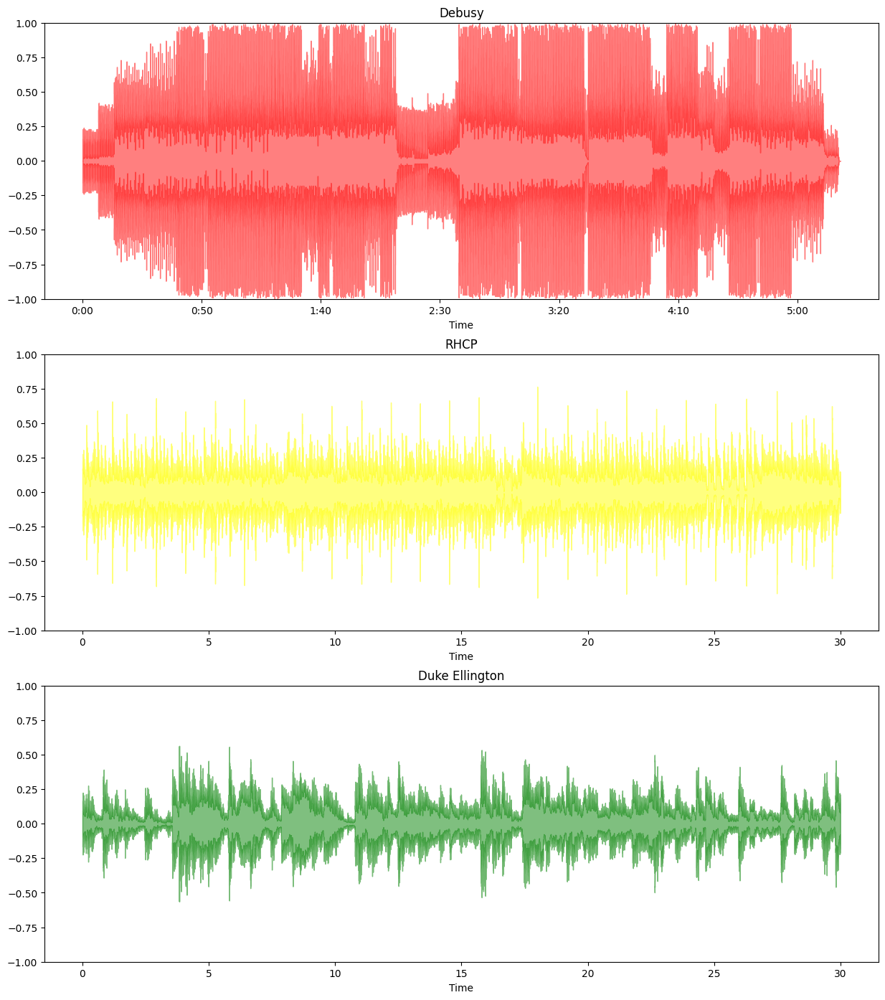

In [63]:
plt.figure(figsize=(15, 17))

plt.subplot(3, 1, 1)
debussy = scale_json(debussy,1)
librosa.display.waveshow(debussy, alpha=0.5, color="red")
plt.ylim((-1, 1))
plt.title("Debusy")

plt.subplot(3, 1, 2)
librosa.display.waveshow(redhot, alpha=0.5, color="yellow")
plt.ylim((-1, 1))
plt.title("RHCP")

plt.subplot(3, 1, 3)
librosa.display.waveshow(duke, alpha=0.5, color="green")
plt.ylim((-1, 1))
plt.title("Duke Ellington")

plt.show()

## Calculating amplitude envelope

In [85]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

def amplitude_envelope(signal, frame_size, hop_length):
    """Calculate the amplitude envelope of a signal with a given frame size nad hop length."""
    amplitude_envelope = []
    
    # calculate amplitude envelope for each frame
    for i in range(0, len(signal), hop_length): 
        amplitude_envelope_current_frame = max(signal[i:i+frame_size]) 
        amplitude_envelope.append(amplitude_envelope_current_frame)
    
    return np.array(amplitude_envelope)    

In [86]:
def fancy_amplitude_envelope(signal, frame_size, hop_length):
    """Fancier Python code to calculate the amplitude envelope of a signal with a given frame size."""
    return np.array([max(signal[i:i+frame_size]) for i in range(0, len(signal), hop_length)])

In [87]:
# number of frames in amplitude envelope
ae_debussy = amplitude_envelope(debussy, FRAME_SIZE, HOP_LENGTH)
ae_debussy = scale_json(ae_debussy, 1)
len(ae_debussy)

13697

In [88]:
# calculate amplitude envelope for RHCP and Duke Ellington
ae_redhot = amplitude_envelope(redhot, FRAME_SIZE, HOP_LENGTH)
ae_duke = amplitude_envelope(duke, FRAME_SIZE, HOP_LENGTH)

## Visualising amplitude envelope

In [89]:
frames = range(len(ae_debussy))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

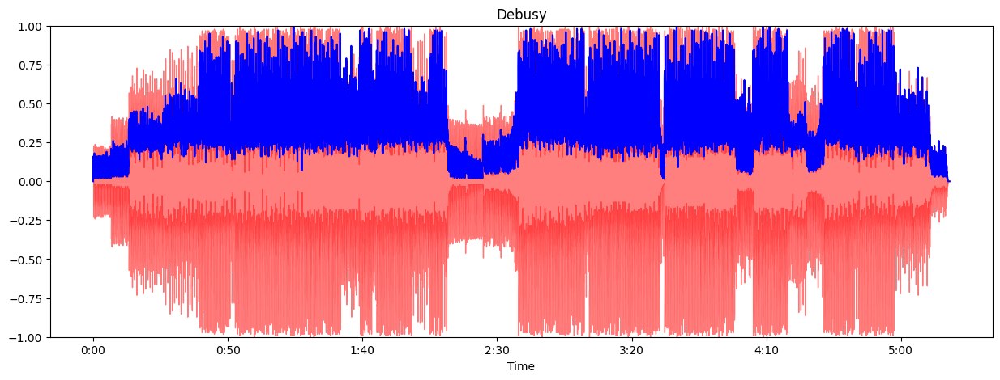

In [90]:
# amplitude envelope is graphed in red

plt.figure(figsize=(15, 17))

ax = plt.subplot(3, 1, 1)
librosa.display.waveshow(debussy, alpha=0.5, color="red")
plt.plot(t, ae_debussy, color="blue")
plt.ylim((-1, 1))
plt.title("Debusy")



plt.show()

In [75]:
debussy[0]

-0.0

In [76]:
print(debussy)

[-0. -0. -0. ... -0. -0. -0.]
